In [2]:
import os
import sys
import copy
import time
import gc

import numpy as np
import dataclasses
import networkx as nx
import matplotlib.pyplot as plt

from typing import Tuple, List, Optional, Dict

In [3]:
import heapq

def dijkstra(start: int, num_node: int, graph: List[List[Tuple]]):
  print("Dijkstra start point: {}".format(start))
  dist = [1e9] * num_node
  pre = [-1] * num_node
  dist[start] = 0
  pre[start] = start

  pq = [(0, start)]
  heapq.heapify(pq)
  while len(pq):
    w, u = heapq.heappop(pq)
    if dist[u] < w:
      continue
    for (v, cost) in graph[u]:
      if dist[v] > dist[u] + cost:
        dist[v] = dist[u] + cost
        pre[v] = u
        heapq.heappush(pq, (dist[v], v))

      
  return dist, pre


In [4]:
def load_input(file_number: int):
  adj = [[1e9 for _ in range(1000)] for i in range(1000)]
  with open(f"../in/{file_number:04d}.txt", "r") as f:
    s = iter(f.read().split("\n"))
    N, M, D, K = map(int, next(s).split())
    U = []
    V = []
    W = []
    X = []
    Y = []
    graph = [[] for _ in range(N)]
    for i in range(M):
      u, v, w = map(int, next(s).split())
      u -= 1
      v -= 1
      U.append(u)
      V.append(v)
      W.append(W)
      adj[u][v] = w
      adj[v][u] = w
      edges.append((u, v, {"color": "black", "width": 1}))
      G.add_edge(u, v)
      graph[u].append((v, w))
      graph[v].append((u, w))
    for i in range(N):
      x, y = map(int, next(s).split())
      X.append(x)
      Y.append(y)

  return N, M, D, K, U, V, W, X, Y, adj, graph

In [20]:
def normal_plot(N, M, D, K, U, V, W, X, Y, ax=None, edge_width=None):
  G = nx.Graph()
  pos = {
    i: (x,y) for i, (x, y) in enumerate(zip(X, Y))
  }
  if edge_width is not None:
    edges = [(u, v, {"color": "black", "width": width}) for u, v, width in zip(U, V, edge_width)]
  else:
    edges = [(u, v, {"color": "black", "width": 1}) for u, v in zip(U, V)]
  G.add_nodes_from(pos.keys())
  G.add_edges_from(edges)
  edge_width = [edge["width"] for edge in G.edges.values()]
  plt.figure(figsize=(10, 10))
  nx.draw(G, pos=pos, node_size=20, ax=ax, width=edge_width)

solve.cpp: In member function 'void Solver::solve3()':
solve.cpp:1489:43: warning: narrowing conversion of '(double)init_score' from 'double' to 'long long int' [-Wnarrowing]
 1489 |         this->best_result = {init_assign, (double)init_score};
      |                                           ^~~~~~~~~~~~~~~~~~
solve.cpp: In member function 'void Solver::solve4()':
solve.cpp:1567:42: warning: narrowing conversion of '(double)cur_score' from 'double' to 'long long int' [-Wnarrowing]
 1567 |         this->best_result = {cur_assign, (double)cur_score};
      |                                          ^~~~~~~~~~~~~~~~~
solve.cpp: In member function 'void Solver::solve5()':
solve.cpp:1754:43: warning: narrowing conversion of '(double)init_score' from 'double' to 'long long int' [-Wnarrowing]
 1754 |         this->best_result = {init_assign, (double)init_score};
      |                                           ^~~~~~~~~~~~~~~~~~
## ENTERING INITIALIZATION 
## FINISHED INIT ##
55981 66117 

989 2757 22 162
219


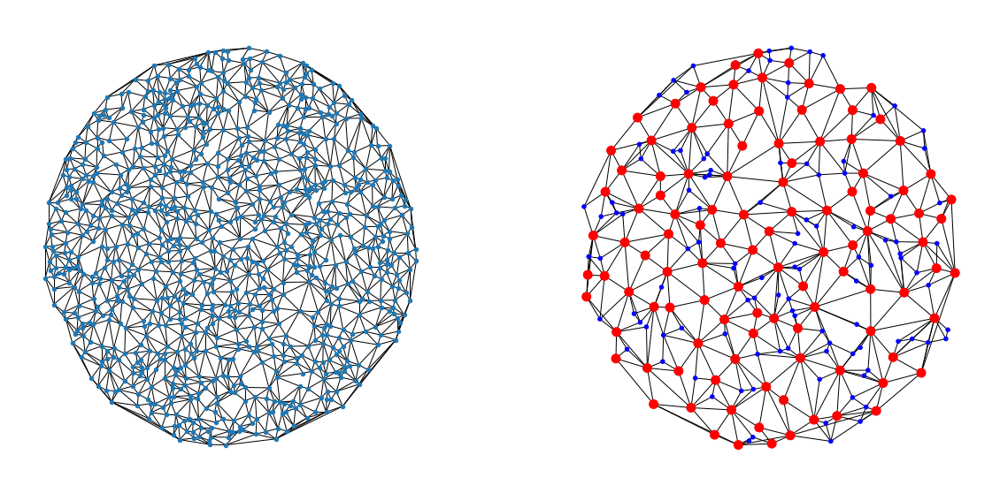

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [21]:
file_number = int(input())
os.system(f"g++ -std=c++17 solve.cpp -D_PYTHON")
os.system(f"./a.out < ../in/{file_number:04}.txt > sample_out.txt")
N, M, D, K, U, V, W, X, Y, _, _ = load_input(file_number=file_number)
fig, axes = plt.subplots(figsize=(20, 10), ncols=2)
normal_plot(N, M, D, K, U, V, W, X, Y, ax=axes[0])
G = nx.Graph()
with open("./sample_out.txt", "r") as f:
  s = f.read()
s = iter(s.split("\n"))
NN = int(next(s).strip())
pos={}
nodes = []
for i in range(NN):
  nid = int(next(s).strip().split()[1])
  color = "blue" if nid < N else "red"
  size = 20 if nid < N else 100
  nodes.append((nid, {"color": color, "size": size}))
  x, y = map(float, next(s).strip().split())
  pos[nid] = (x, y)

print(N, M, D, K)
print(NN)

G.add_nodes_from(nodes)
M = int(next(s).strip())
for i in range(M):
  u, v = map(int, next(s).strip().split())
  G.add_edge(u, v)
colors = [node["color"] for node in G.nodes.values()]
node_sizes=[node["size"] for node in G.nodes.values()]
plt.figure(figsize=(10, 10))
nx.draw(G, pos=pos, node_size=node_sizes, with_labels=False, node_color=colors, ax=axes[1])
plt.show()

## Dijkstra tree

Dijkstra start point: 501


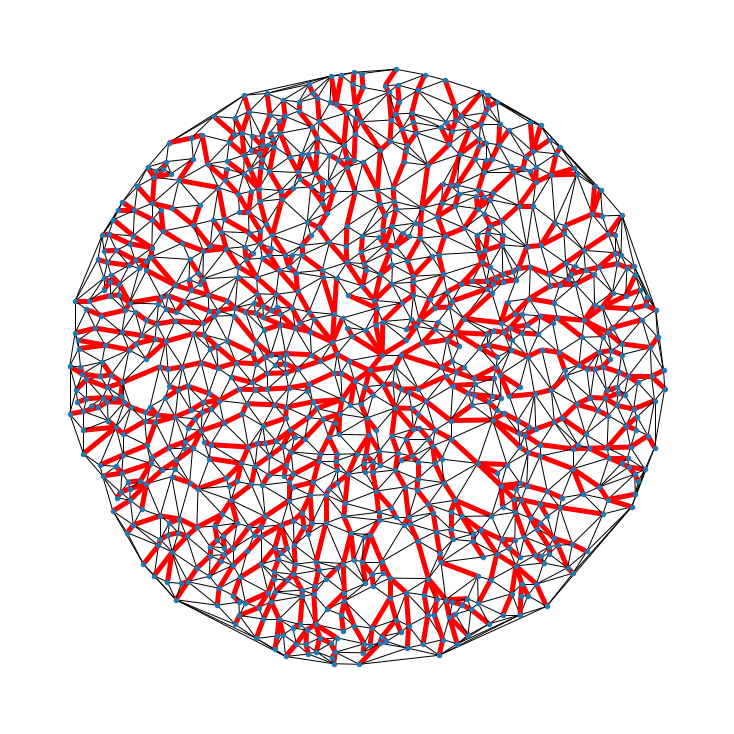

In [6]:
import matplotlib.pyplot as plt

file_number = 0
adj = [[1e9 for _ in range(1000)] for i in range(1000)]
G = nx.Graph()
pos = {}
edges = []
start = 0
max_dist = 1e9
with open(f"../in/{file_number:04d}.txt", "r") as f:
  s = iter(f.read().split("\n"))
  N, M, D, K = map(int, next(s).split())
  U = []
  V = []
  W = []
  X = []
  Y = []
  graph = [[] for _ in range(N)]
  for i in range(M):
    u, v, w = map(int, next(s).split())
    u -= 1
    v -= 1
    U.append(u)
    V.append(v)
    W.append(W)
    adj[u][v] = w
    adj[v][u] = w
    edges.append((u, v, {"color": "black", "width": 1}))
    G.add_edge(u, v)
    graph[u].append((v, w))
    graph[v].append((u, w))
  for i in range(N):
    x, y = map(int, next(s).split())
    X.append(x)
    Y.append(y)
    r2 = (x-500)**2 + (y-500) ** 2
    if r2 < max_dist:
      max_dist = r2
      start = i

dist, pre = dijkstra(start, N, graph)

# visualize
pos = {
    i: (x,y) for i, (x, y) in enumerate(zip(X, Y))
    }

for i, p in enumerate(pre):
  if p == i or p == -1:
    continue
  else:
    edges.append((i, p, {"color": "red", "width": 5}))

G.add_nodes_from(pos.keys())
G.add_edges_from(edges)

edge_color = [edge["color"] for edge in G.edges.values()]
edge_width = [edge["width"] for edge in G.edges.values()]

plt.figure(figsize=(10,10))
nx.draw(G, pos=pos, node_size=20, edge_color=edge_color, width=edge_width)

In [14]:

file_number = 7
adj = [[1e9 for _ in range(1000)] for i in range(1000)]
G = nx.Graph()
pos = {}
edges = []
start = 0
max_dist = 1e9
edge_id_matrix = [[-1 for i in range(1000)] for i in range(1000)]
with open(f"../in/{file_number:04d}.txt", "r") as f:
  s = iter(f.read().split("\n"))
  N, M, D, K = map(int, next(s).split())
  U = []
  V = []
  W = []
  X = []
  Y = []
  graph = [[] for _ in range(N)]
  for i in range(M):
    u, v, w = map(int, next(s).split())
    u -= 1
    v -= 1
    U.append(u)
    V.append(v)
    W.append(W)
    edge_id_matrix[u][v] = i
    edge_id_matrix[v][u] = i
    adj[u][v] = w
    adj[v][u] = w
    edges.append((u, v, {"color": "black", "width": 1}))
    G.add_edge(u, v)
    graph[u].append((v, w))
    graph[v].append((u, w))
  for i in range(N):
    x, y = map(int, next(s).split())
    X.append(x)
    Y.append(y)
    r2 = (x-500)**2 + (y-500) ** 2
    if r2 < max_dist:
      max_dist = r2
      start = i


checked = [False] * M
cnt = 0
while True:
  cnt += 1
  dist, pre = dijkstra(start, N, graph)
  for i, p in enumerate(pre):
    if i == p or p == -1:
      continue
    eid = edge_id_matrix[i][p]
    checked[eid] = True
  
  flag = True
  for i, c in enumerate(checked):
    if not c:
      flag = False
      start = U[i]
      break

  if flag:
    break

print(cnt)
  

Dijkstra start point: 136
Dijkstra start point: 10
Dijkstra start point: 305
Dijkstra start point: 317
Dijkstra start point: 155
Dijkstra start point: 62
Dijkstra start point: 295
Dijkstra start point: 162
Dijkstra start point: 35
Dijkstra start point: 181
Dijkstra start point: 681
Dijkstra start point: 492
Dijkstra start point: 430
Dijkstra start point: 471
Dijkstra start point: 72
Dijkstra start point: 263
Dijkstra start point: 337
Dijkstra start point: 266
Dijkstra start point: 135
Dijkstra start point: 260
Dijkstra start point: 336
Dijkstra start point: 148
Dijkstra start point: 88
Dijkstra start point: 94
Dijkstra start point: 639
Dijkstra start point: 308
Dijkstra start point: 154
Dijkstra start point: 191
Dijkstra start point: 214
Dijkstra start point: 113
Dijkstra start point: 24
Dijkstra start point: 185
Dijkstra start point: 25
Dijkstra start point: 14
Dijkstra start point: 1
Dijkstra start point: 441
Dijkstra start point: 296
Dijkstra start point: 16
Dijkstra start point: 13

## Find triangles

N: 989, M: 2757, D: 22, K: 162


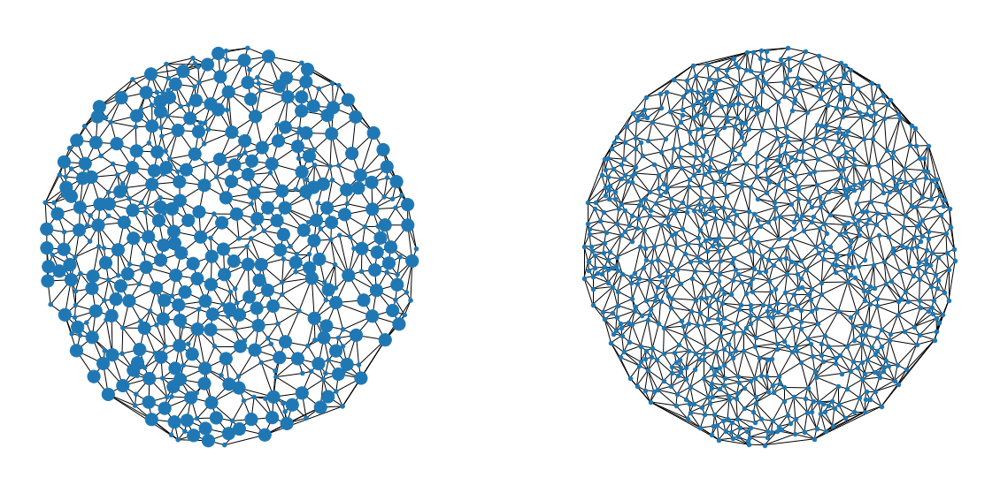

In [14]:
file_number = 0
N, M, D, K, U, V, W, X, Y, adj, graph = load_input(file_number)

@dataclasses.dataclass
class Triangle:
  s: int
  t: int
  u: int
  length: int

  def __gt__(self, other):
    return self.length > other.length
  
  def __lt__(self, other):
    return self.length < other.length


@dataclasses.dataclass
class Metro:
  nodes: List[int]

# Find triangles
used = [[False for _ in range(N)] for _ in range(N)]
triangles = []
for i in range(M):
  u = U[i]
  v = V[i]
  used[u][v] = True
  used[v][u] = True

  for eu in graph[u]:
    s, wij = eu
    if used[s][u] or s == v:
      continue
    
    for es in graph[s]:
      t, wjk = es
      if used[s][t]:
        continue

      if t == v:
        wki = adj[s][v]
        triangle = Triangle(u, v, s, wij + wjk + wki)
        triangles.append(triangle)

triangles.sort()
# print(triangles)

pos = {}
edges = []
nodes = []
labels = [-1] * N
mean_pos = []
cnt = 0

for triangle in triangles:
  s = triangle.s
  t = triangle.t
  u = triangle.u
  if labels[s] == -1 and labels[t] == -1 and labels[u] == -1:
    labels[s] = cnt
    labels[t] = cnt
    labels[u] = cnt
    x = (X[s] + X[t] + X[u]) / 3
    y = (Y[s] + Y[t] + Y[u]) / 3
    mean_pos.append((x, y))
    cnt += 1


for i, label in enumerate(labels):
  if label != -1:
    pos[f"T{label}"] = mean_pos[label]
    nodes.append((f"T{label}", {"size": 200, "pos": mean_pos[label]}))

    for nei in graph[i]:
      j, w = nei
      if labels[j] == label:
        continue
      elif labels[j] == -1:
        edges.append((f"T{label}", f"{j}"))
      else:
        edges.append((f"T{label}", f"T{labels[j]}"))


  else: # label -1
    pos[f"{i}"] = (X[i], Y[i])
    nodes.append((f"{i}", {"size": 20, "pos": (X[i], Y[i])}))
    for nei in graph[i]:
      j, w = nei
      if labels[j] == -1:
        edges.append((f"{i}", f"{j}"))
      else:
        edges.append((f"{i}", f"T{labels[j]}"))


G = nx.Graph()
G.add_nodes_from(nodes)
G.add_edges_from(edges)
node_sizes = [node["size"] for node in G.nodes.values()]

print("N: {}, M: {}, D: {}, K: {}".format(N, M, D, K))

fig, axes = plt.subplots(ncols=2, figsize=(20, 10))
nx.draw(G, pos=pos, node_size=node_sizes, ax=axes[0])
normal_plot(N, M, D, K, U, V, W, X, Y, ax=axes[1])
plt.show()

# Calculate Frequencies
Calculate how many times each edges are used in the shortest paths.

INPUT ENDED
EID: 426, INCREASED F: 3555
Freq EID2: 760
EID: (426,1204), INCREASED F: 5857
EID: 1204, INCREASED F: 2302
Freq EID2: 770
EID: (1204,426), INCREASED F: 5857
EID: 1020, INCREASED F: 3686
Freq EID2: 771
EID: (1020,426), INCREASED F: 7241
EID: 553, INCREASED F: 3796
Freq EID2: 770
EID: (553,426), INCREASED F: 7351
EID: 210, INCREASED F: 3394
Freq EID2: 769
EID: (210,426), INCREASED F: 6948
EID: 230, INCREASED F: 1776
Freq EID2: 770
EID: (230,426), INCREASED F: 5331
EID: 2125, INCREASED F: 1563
Freq EID2: 770
EID: (2125,426), INCREASED F: 5118
EID: 1144, INCREASED F: 1304
Freq EID2: 775
EID: (1144,1510), INCREASED F: 3742
EID: 1957, INCREASED F: 1826
Freq EID2: 770
EID: (1957,426), INCREASED F: 5381
EID: 380, INCREASED F: 1903
Freq EID2: 770
EID: (380,426), INCREASED F: 5458


786 2218 27 120


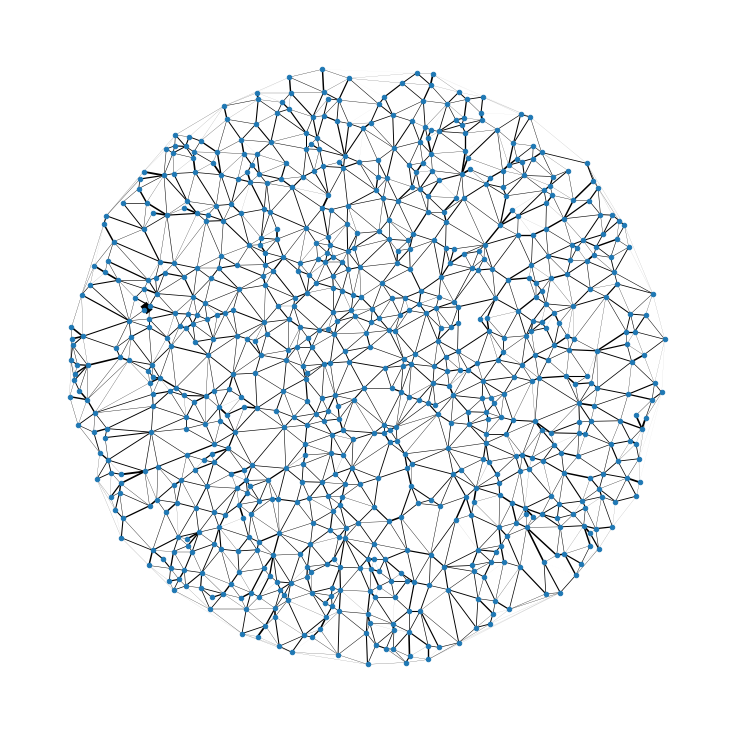

In [138]:
file_number = int(input())
N, M, D, K, U, V, W, X, Y, adj, graph = load_input(file_number=file_number)
os.system(f"./calc_freq < ../in/{file_number:04d}.txt > freq.txt")
edge_width = []
with open("freq.txt", "r") as f:
  lines = f.readlines()
  for line in lines:
    edge_width.append(int(line.strip()))


edge_width = np.array(edge_width)
best_id = np.argmax(edge_width)
edge_width = N * 2 * edge_width / edge_width.sum()
edge_width[best_id] *= 5
print(N, M, D, K)
normal_plot(N, M, D, K, U, V, W, X, Y, edge_width=edge_width)